# Image Generation

## 1.1 Generative adversarial network
#### In this exercise, you will implement a Deep Convolutional Generative Network (DCGAN) to synthesis images by using the provided anime faces dataset.

---


- Construct a <font color=red>**DCGAN**</font> with GAN objective, you can refer to the [tutorial website](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html) provided by PyTorch for implementation.
$$\begin{equation*} \begin{aligned}
&\max _{D} \mathcal{L}(D) =\mathbb{E}_{\boldsymbol{x} \sim p_{\text {data }}} \log D(\boldsymbol{x})+\mathbb{E}_{z \sim p_{\boldsymbol{z}}} \log (1-D(G(\boldsymbol{z}))) \\
&\min _{G} \mathcal{L}(G) =\mathbb{E}_{z \sim p_{x}} \log (1-D(G(\boldsymbol{z}))
\end{aligned} \end{equation*}$$

- <font color=red>Draw</font> some samples generated from your generator at <font color=red>different training stages </font>. For example, you may show the results when running at $5^{\text{th}}$ and final epoch 100. (10\%)


<img src="https://i.imgur.com/tnRR3tr.png" width="350px" />
<img src="https://i.imgur.com/g9AnDwN.png" width="350px" />





In [5]:
# Downlaod and unzip data
!gdown 1K1oB7GOUerTCIa68bbxETcGajLeE_5j1
# !unzip resized_64x64.zip
import zipfile

zip_file = 'resized_64x64.zip'
extract_dir = './'

with zipfile.ZipFile(zip_file, 'r') as zip_ref:
    zip_ref.extractall(extract_dir)

Downloading...
From (uriginal): https://drive.google.com/uc?id=1K1oB7GOUerTCIa68bbxETcGajLeE_5j1
From (redirected): https://drive.google.com/uc?id=1K1oB7GOUerTCIa68bbxETcGajLeE_5j1&confirm=t&uuid=f9c3462d-3ac9-4351-95c2-58313c199be7
To: c:\Users\angus\OneDrive - 國立陽明交通大學\碩一下\深度學習\HW\DL_HW2_2023\resized_64x64.zip

  0%|          | 0.00/125M [00:00<?, ?B/s]
  8%|▊         | 10.5M/125M [00:00<00:01, 101MB/s]
 18%|█▊        | 22.0M/125M [00:00<00:00, 109MB/s]
 27%|██▋       | 33.6M/125M [00:00<00:00, 112MB/s]
 36%|███▌      | 45.1M/125M [00:00<00:00, 112MB/s]
 45%|████▌     | 56.6M/125M [00:00<00:00, 113MB/s]
 55%|█████▍    | 68.2M/125M [00:00<00:00, 112MB/s]
 64%|██████▍   | 79.7M/125M [00:00<00:00, 113MB/s]
 73%|███████▎  | 91.2M/125M [00:00<00:00, 113MB/s]
 82%|████████▏ | 103M/125M [00:00<00:00, 114MB/s] 
 92%|█████████▏| 114M/125M [00:01<00:00, 114MB/s]
100%|██████████| 125M/125M [00:01<00:00, 112MB/s]


### Please write the gan code here

In [8]:
# Please write the gan code here
# Note: In our experience, you can just select around 10000 images for training and get acceptable result.

from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [10]:
# Root directory for dataset
dataroot = "resized_64x64"
# Number of workers for dataloader
workers = 0
# Batch size during training
batch_size = 128
# Spatial size of training images. All images will be resized to this size using a transformer.
image_size = 64
# Number of channels in the training images. For color images this is 3
nc = 3
# Size of z latent vector (i.e. size of generator input)
nz = 100
# Size of feature maps in generator
ngf = 64
# Size of feature maps in discriminator
ndf = 64
# Number of training epochs
num_epochs = 100
# Learning rate for optimizers
lr = 0.0002
# Beta1 hyperparameter for Adam optimizers
beta1 = 0.5
# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

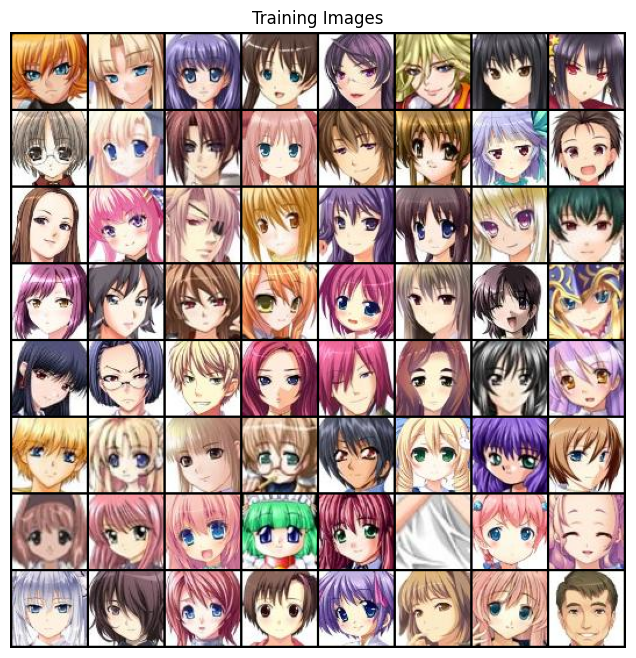

In [11]:
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

import torch.utils.data as data
# Choose a random subset of the dataset
subset_indices = torch.randperm(len(dataset))[:10000]
# Create a subset of the dataset using the indices
subset_dataset = data.Subset(dataset, subset_indices)

# Create the dataloader
dataloader = torch.utils.data.DataLoader(subset_dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [12]:
# custom weights initialization called on ``netG`` and ``netD``
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

### Generator

In [13]:
# Generator Code
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. ``(ngf*8) x 4 x 4``
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. ``(ngf*4) x 8 x 8``
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. ``(ngf*2) x 16 x 16``
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf) x 32 x 32``
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc) x 64 x 64``
        )

    def forward(self, input):
        return self.main(input)
    
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights to ``mean=0``, ``stdev=0.02``.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


### Discriminator

In [14]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is ``(nc) x 64 x 64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf) x 32 x 32``
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2) x 16 x 16``
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4) x 8 x 8``
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8) x 4 x 4``
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)
    
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-GPU if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the ``weights_init`` function to randomly initialize all weights like this: ``to mean=0, stdev=0.2``.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


### Loss Functions and Optimizers

In [15]:
# Initialize the ``BCELoss`` function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

### Training

In [16]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        # if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
        #     with torch.no_grad():
        #         fake = netG(fixed_noise).detach().cpu()
        #     img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
        
    if ((epoch+1)%5 == 0):
        with torch.no_grad():
            fake = netG(fixed_noise).detach().cpu()
        img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

Starting Training Loop...
[0/100][0/79]	Loss_D: 1.4371	Loss_G: 4.5088	D(x): 0.5504	D(G(z)): 0.4691 / 0.0169
[0/100][50/79]	Loss_D: 1.0759	Loss_G: 16.4463	D(x): 0.6550	D(G(z)): 0.0001 / 0.0000
[1/100][0/79]	Loss_D: 0.4634	Loss_G: 4.7367	D(x): 0.8424	D(G(z)): 0.0363 / 0.0435
[1/100][50/79]	Loss_D: 0.4393	Loss_G: 6.7987	D(x): 0.8246	D(G(z)): 0.0881 / 0.0019
[2/100][0/79]	Loss_D: 1.2744	Loss_G: 10.4565	D(x): 0.9434	D(G(z)): 0.6175 / 0.0002
[2/100][50/79]	Loss_D: 0.4453	Loss_G: 7.4014	D(x): 0.9102	D(G(z)): 0.2129 / 0.0013
[3/100][0/79]	Loss_D: 0.5298	Loss_G: 4.8074	D(x): 0.7350	D(G(z)): 0.0220 / 0.0151
[3/100][50/79]	Loss_D: 0.2222	Loss_G: 6.9955	D(x): 0.8541	D(G(z)): 0.0248 / 0.0026
[4/100][0/79]	Loss_D: 0.3937	Loss_G: 5.6829	D(x): 0.7944	D(G(z)): 0.0732 / 0.0081
[4/100][50/79]	Loss_D: 0.2683	Loss_G: 6.5007	D(x): 0.8461	D(G(z)): 0.0343 / 0.0036
[5/100][0/79]	Loss_D: 0.8881	Loss_G: 10.8541	D(x): 0.9504	D(G(z)): 0.5006 / 0.0000
[5/100][50/79]	Loss_D: 0.5432	Loss_G: 6.8140	D(x): 0.9452	D(G(z)

### Results

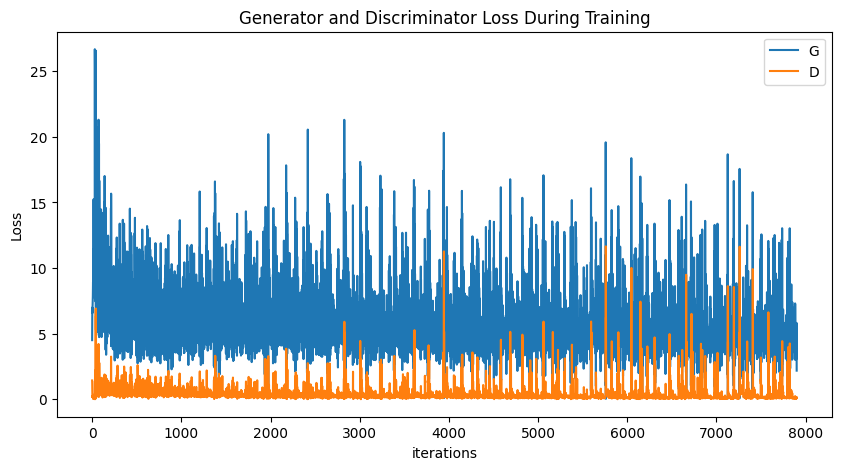

In [17]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

### 1.1.a 
### Draw some samples generated from your generator at different training stages. For example, you may show the results when running at 5th and final epoch 100

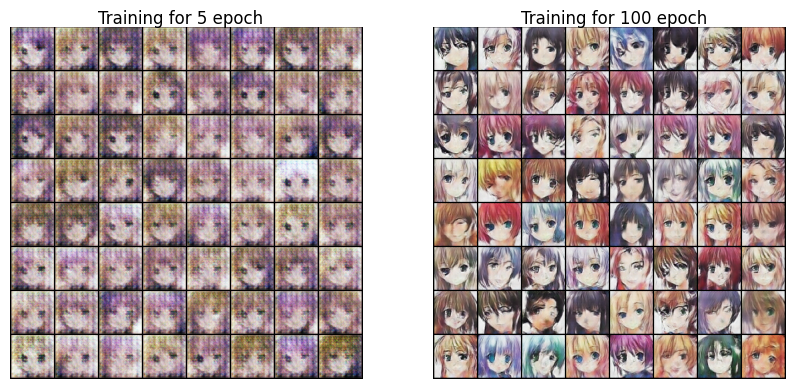

In [18]:
# 創建一個figure，大小為10x5
fig = plt.figure(figsize=(10, 5))

# 添加左側的子圖
ax1 = fig.add_subplot(121)
ax1.imshow(img_list[0].cpu().numpy().transpose(1,2,0))
ax1.text(0.25, 1.01, 'Training for 5 epoch', fontsize=12, transform=ax1.transAxes)
ax1.axis('off')

# 添加右側的子圖
ax2 = fig.add_subplot(122)
ax2.imshow(img_list[19].cpu().numpy().transpose(1,2,0))
ax2.text(0.25, 1.01, 'Training for 100 epoch', fontsize=12, transform=ax2.transAxes)
ax2.axis('off')

# 顯示figure
plt.show()

Animation size has reached 21402011 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


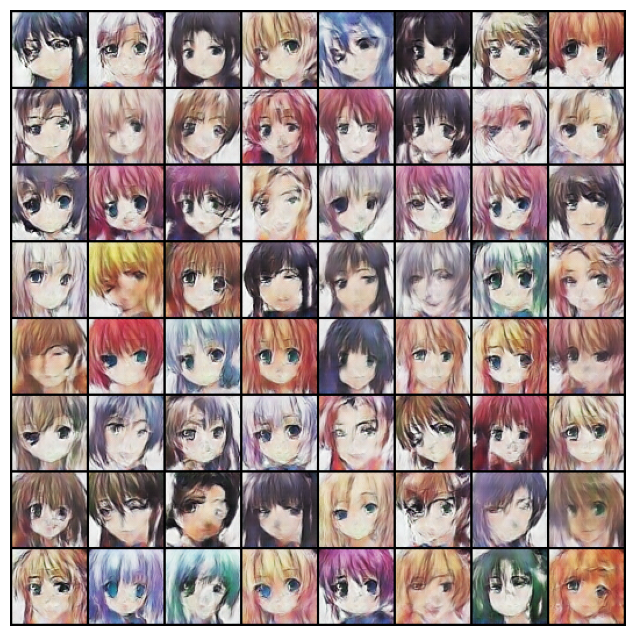

In [19]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

### 1.1.b
### The Helvetica Scenario often happens during the training procedure of GAN. Please explain why this problem occurs and how to avoid it. We suggest you can read the original paper and do the discuss.


Helvetica Scenario 是 GAN 訓練過程中常見的問題。無論輸入的隨機噪聲 z 的值是什麼，生成器都傾向於生成相同的樣本 (或等效地崩潰到相同的模式)。這會導致生成器失去多樣性和創造力，產生的樣本缺乏差異性和多樣性。這種問題通常是由於生成器和判別器之間的失衡導致的，其中判別器優勢過於強大，它趨向於將生成器產生的樣本歸類為相同的類別，進而讓生成器在該類別中生成相似的樣本，最終導致模式崩潰。

避免模式崩潰，可以使用以下策略：
1.改變訓練策略：如改變初始值、超參數、優化器等參數，調整生成器和判別器之間的平衡，或者使用不同的損失函數。
2.增加噪聲：在生成器的輸入中加入噪聲，以增加生成器的隨機性。
3.手動平衡生成器和判別器：根據生成器和判別器的性能，手動調整兩者之間的權重，以使生成器和判別器之間達到平衡。
4.使用正則化技術：如L1/L2正則化、dropout等技術，可以幫助生成器避免過擬合訓練集，增加模型的泛化能力。

## 1.2 Denoising Diffusion Probabilistic Model (30%)

#### In this exercise, you will implement a <font color=red>Denoising Diffusion Probabilistic Model (DDPM) </font>to generate images by the provided  <font color=red>anime faces dataset</font>. The Figure below is the process of the Diffusion Model. It consists of a forward process, which gradually adds noise, and the reverse process will transform the noise back into a sample from the target distribution. Here is the [link1](https://lilianweng.github.io/posts/2021-07-11-diffusion-models/) and [link2](https://www.youtube.com/watch?v=azBugJzmz-o&t=190s) to the detailed introduction to the diffusion model. 

<img src="https://i.imgur.com/BqpRi4v.png"/>

1. Construct  <font color='blue'>DDPM</font> by fulfilling the <font color='red'>2 TODOs</font> and follow the instruction. Noticed that you are not allowed to directly call library or API to load the model. The total epoch is 10. (20\%)

  (a) **Draw** some generated samples based on diffusion steps $T = 500$ and $T = 1000$. We provide the **pre-trained weights** which are trained with 500 and 1000 steps. Hint: In the paper, the steps start at 1..

  (b) **Discuss** the result based on different diffusion steps.

### Training (You can skip this)

- Notice that becuase the diffusion requires high computational device, Colab may not be suitable. Thus, we provide the code of Training for reference. 

In [ ]:
#下載dataloader.py及model.py
!gdown 1E8yulcTDMk9dvz2dJ_TniLKdU4n6AFwa
!gdown 1g_RYSP1A2rXg_ud18ARlWXK8BWhiHdjV

In [ ]:
!pip install torchmetrics

In [ ]:
import torch, sys
from torch.optim import Adam
from torch.optim.lr_scheduler import StepLR
from tqdm import tqdm, trange
from model import Unet
from torchmetrics import MeanMetric
from dataloader import get_loader

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device) #make sure this is cuda

In [ ]:
T = 500
ALPHA = 1-torch.linspace(1e-4, 2e-2, T)
def alpha(t):
    at = torch.prod(ALPHA[:t]).reshape((1, ))
    return torch.sqrt(torch.cat((at, 1-at)))
ALPHA_bar = torch.stack([alpha(t) for t in range(T)]).to(device)

batch_size = 64
update_step = 1
save_step = 2
save_step_ = 20
num_workers = 6
epochs = 100
loss_func = torch.nn.MSELoss()
lr = 5e-4
model = Unet(
    in_channels=3
)
state_dict = torch.load('checkpoint.pth')
optimizer = Adam(model.parameters(), lr=lr)
scheduler = StepLR(optimizer, step_size=10, gamma=0.5)

In [7]:
def train(model, data_loader):
    running_loss = MeanMetric(accumulate=True)

    model.train()
    optimizer.zero_grad()

    for epoch in (overall:=trange(1, epochs+1, position=1, desc='[Overall]')):
        running_loss.reset()

        for i, X_0 in enumerate(bar := tqdm(data_loader, position=0, desc=f'[Train {epoch:3d}] lr={scheduler.get_last_lr()[0]:.2e}'), start=1):
            X_0 = X_0.to(device) #X_0表示batch數量
            eps = torch.randn(X_0.shape, device=device)
            t = torch.randint(0, T, (X_0.shape[0], ), device=device)

            # print(ALPHA_bar[t, 0].reshape(-1, 1, 1, 1)*X_0)
            with torch.no_grad():
                X_noise = ALPHA_bar[t, 0].reshape(-1, 1, 1, 1)*X_0 + ALPHA_bar[t, 1].reshape(-1, 1, 1, 1)*eps
            # X_noise = X_noise.to(device)
            t = t.to(device)
            
            pred = model(X_noise, t+1)

            loss = loss_func(eps, pred)
            loss.backward()

            if i%update_step == 0 or i == bar.total:
                optimizer.step()
                optimizer.zero_grad()

            running_loss.update(loss.item())
            bar.set_postfix_str(f'loss {running_loss.compute():.2e}')

        scheduler.step()
        tqdm.write('\r\033[K', end='')

        if epoch % save_step == 0:
            save_checkpoint(epoch, model, optimizer, 'checkpoint.pth')
        if epoch % save_step_ == 0:
            save_checkpoint(epoch, model, optimizer, f'checkpoint_{epoch}.pth')    

def save_checkpoint(epoch, model, optimizer, path):
    torch.save({
        'epoch': epoch,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'scheduler_state_dict': scheduler.state_dict()
    }, path)
    tqdm.write('Save checkpoint')

In [ ]:
# Training start
train_loader = get_loader(
    'resized_64x64/',
    batch_size, 
    num_workers
)
model = model.to(device)
train(model, train_loader)

### Sampling

In [11]:
!gdown 1E8yulcTDMk9dvz2dJ_TniLKdU4n6AFwa 
# dataloader.py
!gdown 1g_RYSP1A2rXg_ud18ARlWXK8BWhiHdjV 
# model.py
!gdown 1n9K-HSY3GJKTS4HkHTCA_AJT0q1cKBZ1 
# checkpoint_epoch100_T1000.pth
!gdown 1jPycQFo_f_fPRUg6OuauTrsXbdibTvKI 
# checkpoint_epoch100_T500.pth

Downloading...
From (uriginal): https://drive.google.com/uc?id=1E8yulcTDMk9dvz2dJ_TniLKdU4n6AFwa
From (redirected): https://drive.google.com/uc?id=1E8yulcTDMk9dvz2dJ_TniLKdU4n6AFwa&confirm=t&uuid=392ef5a7-5897-4e66-9ced-974b6b794581
To: c:\Users\angus\OneDrive - 國立陽明交通大學\碩一下\深度學習\HW\DL_HW2_2023\dataloader.py

  0%|          | 0.00/2.15k [00:00<?, ?B/s]
100%|██████████| 2.15k/2.15k [00:00<?, ?B/s]
Downloading...
From (uriginal): https://drive.google.com/uc?id=1g_RYSP1A2rXg_ud18ARlWXK8BWhiHdjV
From (redirected): https://drive.google.com/uc?id=1g_RYSP1A2rXg_ud18ARlWXK8BWhiHdjV&confirm=t&uuid=6305d7d2-a02d-4085-bbe6-5e4f5ffdd913
To: c:\Users\angus\OneDrive - 國立陽明交通大學\碩一下\深度學習\HW\DL_HW2_2023\model.py

  0%|          | 0.00/8.75k [00:00<?, ?B/s]
100%|██████████| 8.75k/8.75k [00:00<?, ?B/s]
Downloading...
From (uriginal): https://drive.google.com/uc?id=1n9K-HSY3GJKTS4HkHTCA_AJT0q1cKBZ1
From (redirected): https://drive.google.com/uc?id=1n9K-HSY3GJKTS4HkHTCA_AJT0q1cKBZ1&confirm=t&uuid=066a2dae-

In [27]:
import torch, os
from tqdm import trange, tqdm
from torchvision.utils import save_image
from torchvision.transforms import ColorJitter
import torch, sys
from tqdm import tqdm, trange
from model import Unet

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device) # cuda is recommand
T = 1000   # 500 or 1000
model = Unet(in_channels=3).to(device)
state_dict = torch.load('checkpoint_100epoch_T1000.pth', map_location='cpu')
model.load_state_dict(state_dict['model_state_dict'])

cpu


<All keys matched successfully>

In [28]:
ALPHA = (1-torch.linspace(1e-4, 2e-2, T)).reshape((-1, 1)).to(device)
def alpha(t):
    at = torch.prod(ALPHA[:(t+1)]).reshape((1, ))
    return torch.sqrt(torch.cat((at, 1-at)))
ALPHA_bar = torch.stack([alpha(t) for t in range(T)]).to(device)
sigma = torch.sqrt(torch.linspace(1e-4, 2e-2, T)).reshape((-1, 1)).to(device) #beta開根號

@torch.no_grad()
def generate_and_save(model, gen_N, chan=3, resolu=(28, 28)):
    model.eval()
    

    L = []

    # ----- TODO ----- #
    # Sample gaussian noise X_T (5%). Please see DDPM paper https://arxiv.org/pdf/2006.11239.pdf or the link in the homework pdf file 
    X_T = torch.randn(gen_N, chan, *resolu).to(device) #*可將tuple解包
    # ----- TODO ----- #

    for t in (bar := trange(T-1, -1, -1)):

        bar.set_description(f'[Denoising] step: {t}')

        # ----- TODO ----- #
        # Sampling: Please see DDPM paper https://arxiv.org/pdf/2006.11239.pdf or the link in the homework pdf file
        eps = torch.randn(gen_N, chan, *resolu).to(device)
        alpha = ALPHA[t]
        k = torch.tensor(t, device=device).view(1,)
        X_T = 1/torch.sqrt(alpha)* (X_T-(1-alpha)/ALPHA_bar[t,1]*model(X_T, k)) + sigma[t] * eps 
        # ----- TODO ----- #

        if t < 1:
            L.append(X_T)
    
    save_image(torch.cat(L)/2+0.5, 'L_1000.jpg')

### 1.2.a 
#### **Draw** some generated samples based on diffusion steps $T = 500$ and $T = 1000$. We provide the **pre-trained weights** which are trained with 500 and 1000 steps. Hint: In the paper, the steps start at 1..

In [29]:
# gen_N is the setting of output images number
# resolu is the setting of output images resolution, you should not change this.
# This function will automatically save the sample images, what you need to do is to show in here.
generate_and_save(model, gen_N=64, resolu=(64, 64))

[Denoising] step: 0: 100%|██████████| 1000/1000 [1:48:36<00:00,  6.52s/it] 


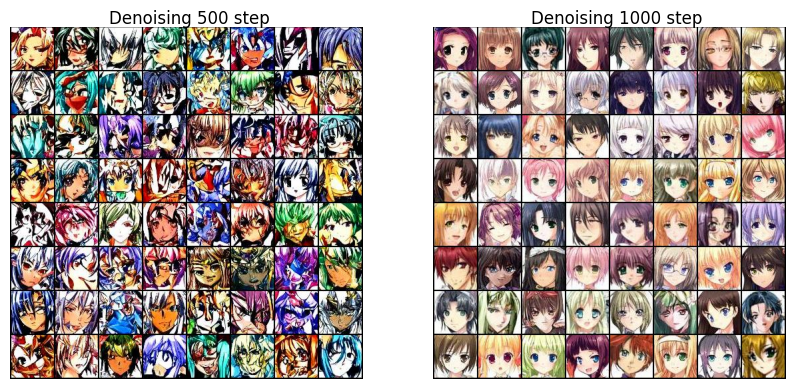

In [32]:
from PIL import Image
# 創建一個figure，大小為10x5
fig = plt.figure(figsize=(10, 5))

# 添加左側的子圖
ax1 = fig.add_subplot(121)
img1 = Image.open('L_500.jpg')
ax1.imshow(img1)
ax1.text(0.28, 1.01, 'Denoising 500 step ', fontsize=12, transform=ax1.transAxes)
ax1.axis('off')

# 添加右側的子圖
ax2 = fig.add_subplot(122)
img2 = Image.open('L_1000.jpg')
ax2.imshow(img2)
ax2.text(0.28, 1.01, 'Denoising 1000 step', fontsize=12, transform=ax2.transAxes)
ax2.axis('off')

# 顯示figure
plt.show()

### 1.2.b
#### **Discuss** the result based on different diffusion steps.

在 DDPM 中，擴散步驟的數量對生成結果有很大的影響。實驗結果表明，當擴散步驟較少時，生成的圖像樣本會比較模糊，經常出現噪點和細節缺失的問題；當擴散步驟較多時，生成的圖像樣本會比較清晰，細節更加豐富，但同時也更容易出現過擬合的問題。因此，選擇合適的擴散步驟數量是非常重要的。

## 1.3 Comparison between GAN and DDPM (10%)
#### (a) Both GAN and DDPM are generative models. The following figures are randomly generated results by using GAN (left) and DDPM (right). Please describe the pros and cons of the two models. (10%)

<img src="https://i.imgur.com/pU77cfa.jpg" width="600px"/>

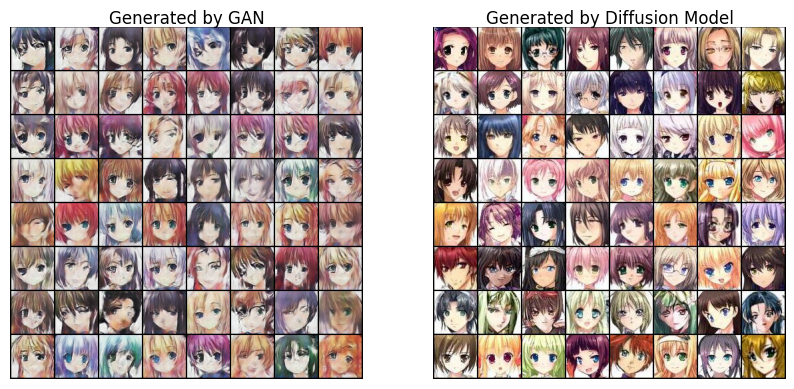

In [33]:
# 創建一個figure，大小為10x5
fig = plt.figure(figsize=(10, 5))

# 添加左側的子圖
ax1 = fig.add_subplot(121)
ax1.imshow(img_list[19].cpu().numpy().transpose(1,2,0))
ax1.text(0.28, 1.01, 'Generated by GAN', fontsize=12, transform=ax1.transAxes)
ax1.axis('off')

# 添加右側的子圖
ax2 = fig.add_subplot(122)
img = Image.open('L_1000.jpg')
ax2.imshow(img)
ax2.text(0.15, 1.01, 'Generated by Diffusion Model', fontsize=12, transform=ax2.transAxes)
ax2.axis('off')

# 顯示figure
plt.show()

### 1.3.a
### Both GAN and DDPM are generative models. The figures are randomly generated results by using GAN (left) and DDPM (right). Please describe the pros and cons of the two models based on your observation.

GAN的優點:
1.視覺成像：GAN能夠生成逼真和高質量的圖像，因為使用了對抗性訓練，其中生成器和判別器之間的競爭迫使生成器生成更真實的圖像。
2.多樣性：GAN能夠生成多樣性的圖像，因為它們可以學習到輸入噪聲和目標圖像之間的非線性映射關係，從而生成不同風格、角度和變體的圖像。
GAN的缺點:
1.不穩定性：GAN的訓練過程往往不穩定，容易出現模式崩潰、模式塌陷等問題，導致生成的圖像缺乏多樣性或質量不佳。
2.訓練難度：訓練一個高質量的GAN模型需要大量的數據和計算資源，以及對超參數的精心調整和調試。

DDPM的優點：
1.穩定性：相較於GAN，DDPM模型的訓練過程更穩定，更容易收斂到高質量的結果。
2.可控性：DDPM模型通常可以提供更好的控制，例如可以根據需求調整生成圖像的清晰度、細節或風格。
DDPM模型的缺點：
1.複雜性：DDPM模型的設計和實現相對複雜，需要更多的計算資源和技術知識。
2.生成速度：相對於GAN，DDPM模型的生成速度可能較慢，因為它們通常需要進行更多的計算步驟和迭代。

觀察兩個模型所生成的圖像，個人認為DDPM模型所生成的圖像在細節還原做得比GAN還要好，但相信可以透過超參數的調整已及增加訓練迭帶次數獲得改善。